# Required Assignment 11.1: What Drives the Price of a Car?
___

<center>
    <img src = images/kurt.jpeg>
</center>

### OVERVIEW
___
In this application, you will explore a dataset from Kaggle. The original dataset contained information on 3 million used cars. The provided dataset contains information on 426K cars to ensure speed of processing. Your goal is to understand what factors make a car more or less expensive. As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework
___
<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications, we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding
From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

Answer:<br>
**The task is to predict or identify car prices using features such as car age, mileage, brand, model, and condition. We will be building a regression model where the target variable is the car price and the input variables are the potential predictors. We aim to identify which features have the most significant impact on pricing.**

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

**Answer:**

**Load the dataset and display the first few rows to see what information is available.**

In [115]:
import pandas as pd

vehicles = pd.read_csv("data/vehicles.csv")
vehicles.head(5)

,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


**To see the summary and basic statistics of the numeric features in the dataset. To see an overview of the dataset: number of columns, column names, data types of each columns, number of non-null values (to spot the missing data).**

In [116]:
vehicles.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

**To display a statistical summary (count, mean, min, max, quartiles, etc.) of all numeric columns in the vehicles dataset.** <br>
The numeric summary shows that most cars in the dataset are priced between about `$6,000` and `$26,000`, with a median of `$13,950`, but there are extreme outliers pushing the maximum into the billions, which are clearly unrealistic. The car years mostly range from 2008 to 2017, though an invalid minimum year of 1900 appears. For mileage, the median is around 85,000 miles, but there are also suspicious values such as 0 and an unrealistic maximum of 10 million miles. These patterns suggest the data is informative but contains errors and outliers that should be cleaned before further analysis.

In [117]:
print("\nNumeric Columns Summary:")
print(vehicles.describe())


Numeric Columns Summary:
                 id         price           year      odometer
count  4.268800e+05  4.268800e+05  425675.000000  4.224800e+05
mean   7.311487e+09  7.519903e+04    2011.235191  9.804333e+04
std    4.473170e+06  1.218228e+07       9.452120  2.138815e+05
min    7.207408e+09  0.000000e+00    1900.000000  0.000000e+00
25%    7.308143e+09  5.900000e+03    2008.000000  3.770400e+04
50%    7.312621e+09  1.395000e+04    2013.000000  8.554800e+04
75%    7.315254e+09  2.648575e+04    2017.000000  1.335425e+05
max    7.317101e+09  3.736929e+09    2022.000000  1.000000e+07


**This generates a concise summary of the dataset to help with data understanding and quality checks.** <br>
It shows the data type of each column, how many non-missing values are present, how many values are missing, and the number of unique values (a value that appears only once in a column, not repeated.). This makes it easier to identify categorical features, detect incomplete columns, and spot potential issues that may need cleaning before furthe

In [118]:
vehicles = pd.read_csv("data/vehicles.csv")

summary = pd.DataFrame({
    "Data Type": vehicles.dtypes,
    "Non-Null Count": vehicles.notnull().sum(),
    "Missing Count": vehicles.isnull().sum(),
    "Unique Values": vehicles.nunique()
})
print(summary)

             Data Type  Non-Null Count  Missing Count  Unique Values
id               int64          426880              0         426880
region          object          426880              0            404
price            int64          426880              0          15655
year           float64          425675           1205            114
manufacturer    object          409234          17646             42
model           object          421603           5277          29649
condition       object          252776         174104              6
cylinders       object          249202         177678              8
fuel            object          423867           3013              5
odometer       float64          422480           4400         104870
title_status    object          418638           8242              6
transmission    object          424324           2556              3
VIN             object          265838         161042         118246
drive           object          29

**The histogram shows that car prices are heavily skewed to the right, with most vehicles clustered at lower price ranges.** <br>
Extreme outliers reach up to `$190` million, and a spike at `$0` indicates missing or placeholder values. With over `426,000` entries, the majority of cars fall well below the maximum prices, highlighting the need to remove unrealistic values and handle zero prices before analysis.

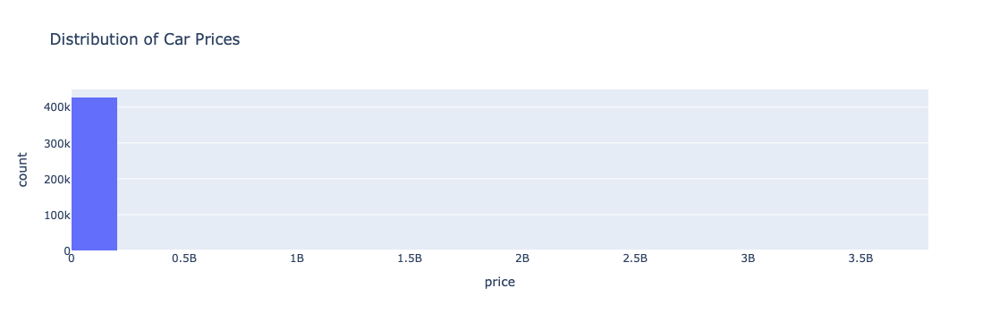

In [119]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt

vehicles = pd.read_csv("data/vehicles.csv")

# Histogram for 'Price'
fig = px.histogram(vehicles, x='price', nbins=20, title='Distribution of Car Prices')
fig.show()

**The box plot confirms the findings from the histogram, showing that the distribution of car prices is heavily skewed to the right.** <br> 
The vast majority of cars are priced below $57,341. However, the plot also clearly visualizes the existence of a small number of extremely expensive cars, which are considered outliers, with prices reaching into the billions of dollars.

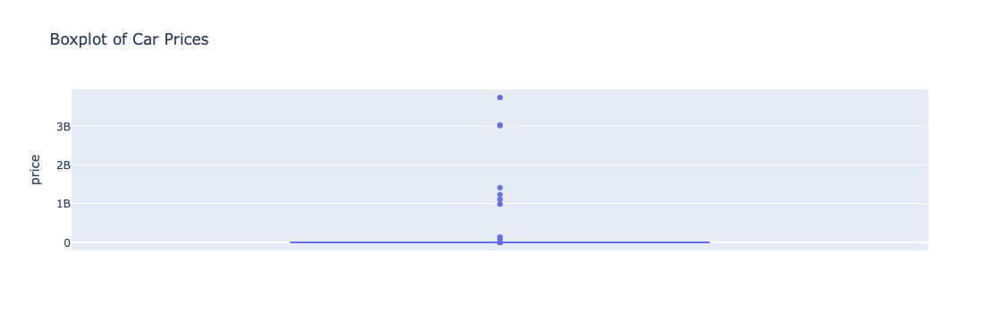

In [120]:
fig = px.box(vehicles, y='price', title='Boxplot of Car Prices')
fig.show()

**The scatter plot highlights the lack of a simple relationship between a car's price and its mileage.** <br> 
While most cars fall into a general, lower-priced range, the distribution is heavily influenced by a few extremely expensive and/or high-mileage outliers.


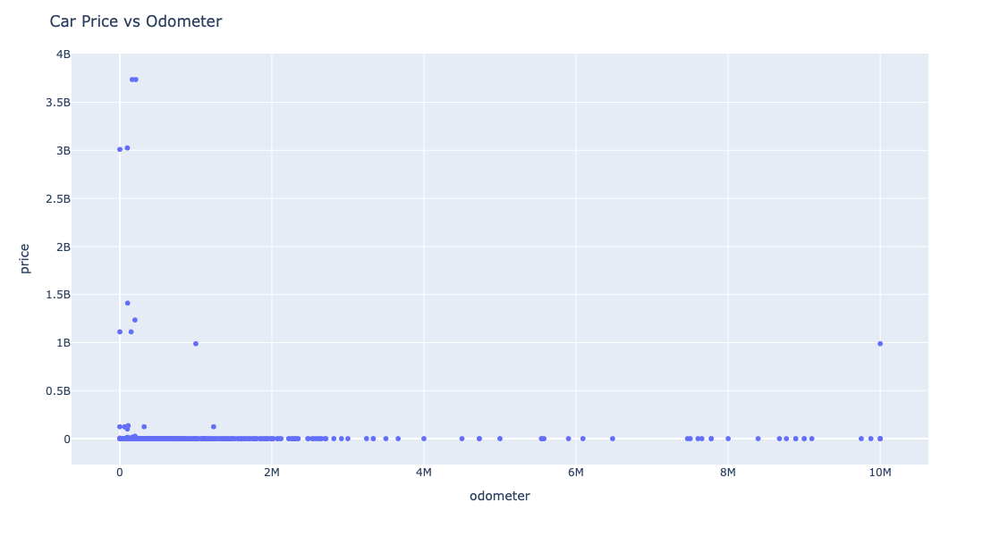

In [122]:
import seaborn as sns
import plotly.express as px

# Load dataset
vehicles = pd.read_csv("practical_application_II_starter/data/vehicles.csv")

# Simple square scatter plot without negatives
fig = px.scatter(vehicles, x="odometer", y="price")

# Force square plot and zero-based axes
fig.update_layout(
    width=900,
    height=600,
    title="Car Price vs Odometer"  
 )

fig.show()

### Data Preparation

After our initial exploration and fine-tuning of the business understanding, it is time to construct our final dataset prior to modeling. Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with sklearn.

**Import libraries**

In [123]:
import pandas as pd
import numpy as np
from sklearn import linear_model
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestRegressor
from sklearn.compose import ColumnTransformer

**Load the data**

In [124]:
vehicles = pd.read_csv("data/vehicles.csv")

**Check for missing values**

In [125]:
vehicles.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

**Make a copy of the raw dataset**

In [126]:
import pandas as pd

# Load raw data
vehicles = pd.read_csv("data/vehicles.csv")

# Create a copy to clean
clean_vehicles = vehicles.copy()

**Fill or drop missing values:** <br>
We use the median to fill missing numeric data because it represents a typical value without being skewed by outliers.

In [127]:
### import pandas as pd
import numpy as np

# Separate numeric and categorical columns
numeric_cols = clean_vehicles.select_dtypes(include=[np.number]).columns
categorical_cols = clean_vehicles.select_dtypes(include=['object', 'category']).columns

# Fill numeric columns with median
for col in numeric_cols:
    clean_vehicles[col] = clean_vehicles[col].fillna(clean_vehicles[col].median())

# Categorical columns → fill with 'Unknown'
for col in categorical_cols:
    clean_vehicles[col] = clean_vehicles[col].fillna('Unknown')

clean_vehicles = clean_vehicles.drop(['id', 'VIN'], axis = 1)

In [128]:
clean_vehicles.isnull().sum()

region          0
price           0
year            0
manufacturer    0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
title_status    0
transmission    0
drive           0
size            0
type            0
paint_color     0
state           0
dtype: int64

**The histogram shows the distribution of vehicle prices, with the data zoomed in to the range of `$0` to `$100,000`.** <br> 
The x-axis represents the price in dollars, and the y-axis shows the count of vehicles at each price point. The plot is heavily skewed to the right, indicating that the majority of vehicles are priced at the lower end of the spectrum, with a very high count of vehicles priced under `$10,000`. As the price increases, the number of vehicles decreases significantly, with very few vehicles priced above `$60,000`.


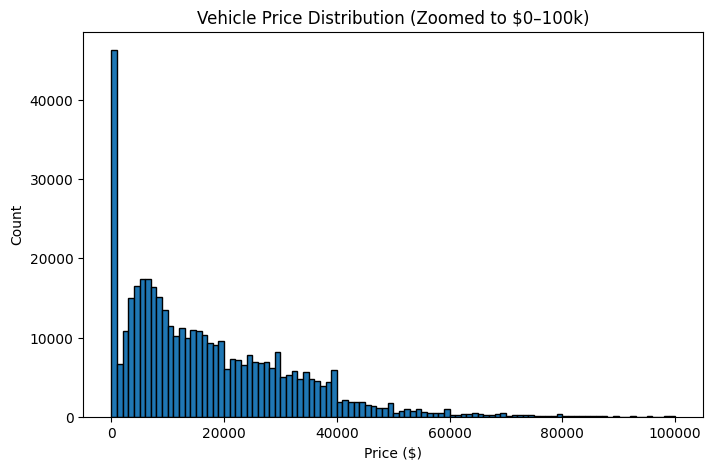

In [129]:
plt.figure(figsize=(8,5))
plt.hist(clean_vehicles['price'], bins=100, range=(0,100000), edgecolor='black')
plt.title("Vehicle Price Distribution (Zoomed to $0–100k)")
plt.xlabel("Price ($)")
plt.ylabel("Count")
plt.savefig("images/vehicle_price_distribution_zoomed.png", dpi=300, bbox_inches="tight")
plt.show()

**This calculates a comprehensive statistical summary of the price column from the clean_vehicles dataset and then formats each of the resulting statistics into a readable dollar string.** <br>
This process helps to quickly understand key characteristics of the vehicle prices, such as the average, minimum, maximum, and median prices, in a clear, presentable format.

In [130]:
# Get descriptive stats
desc = clean_vehicles['price'].describe()

# Format each value as dollar string
desc_dollars = desc.apply(lambda x: f"${x:,.0f}")
print(desc_dollars)

count          $426,880
mean            $75,199
std         $12,182,282
min                  $0
25%              $5,900
50%             $13,950
75%             $26,486
max      $3,736,928,711
Name: price, dtype: object


**This filters a dataset of vehicle prices, creating a new dataset that includes only vehicles priced between `$1,000` and $`100,000`.** <br> 
It then prints a summary showing the number of vehicles in the original dataset and the number remaining after the filtering process. This is a common data cleaning step to remove extreme outliers or invalid price entries.

In [131]:
# Keep only cars priced between $1,000 and $100,000
filtered_vehicles = clean_vehicles[
    (clean_vehicles['price'] >= 1000) & (clean_vehicles['price'] <= 100000)
]

print(f"Original size: {len(clean_vehicles)}, Filtered size: {len(filtered_vehicles)}")

Original size: 426880, Filtered size: 379910


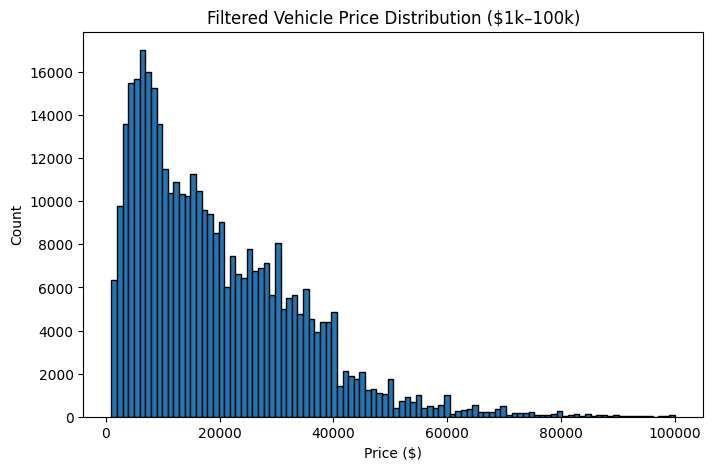

In [132]:
plt.figure(figsize=(8,5))
plt.hist(filtered_vehicles['price'], bins=100, edgecolor='black')
plt.title("Filtered Vehicle Price Distribution ($1k–100k)")
plt.xlabel("Price ($)")
plt.ylabel("Count")
plt.savefig("images/vehicle_price_distribution_filtered.png", dpi=300, bbox_inches="tight")
plt.show()

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

### Linear Regression Pipeline

In [133]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import warnings
warnings.filterwarnings('ignore', category=UserWarning, module='sklearn.preprocessing._encoders')

# Separate features and target
X = filtered_vehicles.drop("price", axis=1)
y = np.log1p(filtered_vehicles['price'])  # log(1 + price)

# Train-test split
X_train_linear, X_test_linear, y_train_linear, y_test_linear = train_test_split(X, y, test_size=0.2, random_state=42)

# Identify column types
categorical_cols = X.select_dtypes(include=['object']).columns.tolist()
numeric_cols = X.select_dtypes(include=['int64','float64']).columns.tolist()

# Preprocessing: scale numeric, one-hot encode categorical
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_cols)
    ]
)

# Build Linear Regression pipeline
linear_pipeline = Pipeline([
    ('preprocess', preprocessor),
    ('model', LinearRegression())
])

# Cross-validation (5-fold) - RMSE
cv_scores = cross_val_score(linear_pipeline, X_train_linear, y_train_linear, cv=5, scoring='neg_mean_squared_error')
rmse_scores = np.sqrt(-cv_scores)
print(f"Linear Regression CV Mean RMSE: {rmse_scores.mean():.2f} | Std: {rmse_scores.std():.2f}")

Linear Regression CV Mean RMSE: 0.48 | Std: 0.00


In [134]:
# Fit on full training data
linear_pipeline.fit(X_train_linear, y_train_linear)

,steps,"[('preprocess', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [135]:
# Predict on test set
y_pred_linear = linear_pipeline.predict(X_test_linear)

In [136]:
# invert the log(1 + price) transform to get predictions in original price units
y_test_orig_linear = np.expm1(y_test_linear)   # true prices
y_pred_orig_linear = np.expm1(y_pred_linear)   # predicted prices (dollars)

In [137]:
# Evaluate
# metrics on original scale (dollars)
mse_orig_linear = mean_squared_error(y_test_orig_linear, y_pred_orig_linear)
rmse_orig_linear = np.sqrt(mse_orig_linear)
mae_orig_linear = mean_absolute_error(y_test_orig_linear, y_pred_orig_linear)
r2_orig_linear = r2_score(y_test_orig_linear, y_pred_orig_linear)

print(f"Test RMSE (original scale): ${rmse_orig_linear:,.2f}")
print(f"Test MSE  (original scale): ${mse_orig_linear:,.2f}")
print(f"Test MAE  (original scale): ${mae_orig_linear:,.2f}")
print(f"Test R2   (original scale): {r2_orig_linear:.3f}")

Test RMSE (original scale): $7,794.01
Test MSE  (original scale): $60,746,647.53
Test MAE  (original scale): $4,446.29
Test R2   (original scale): 0.706


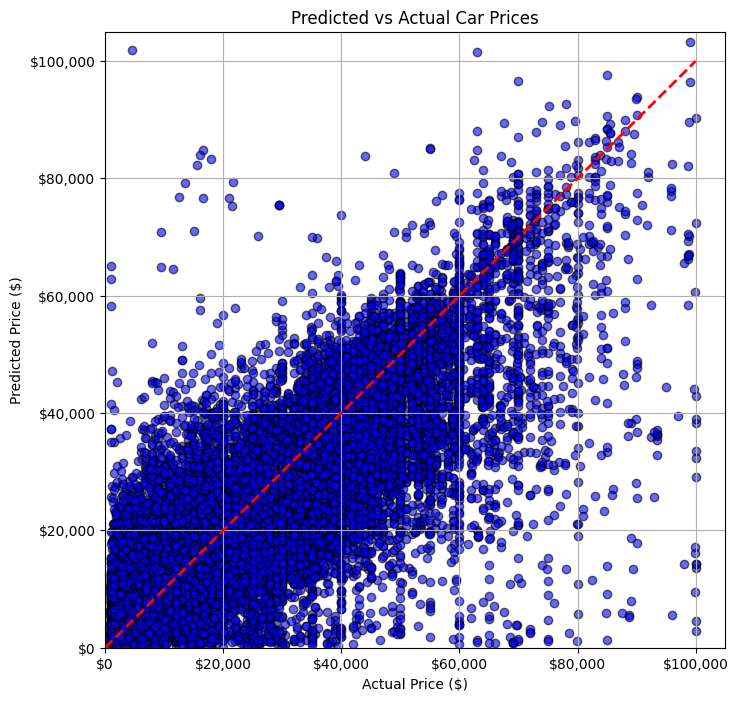

In [138]:
import matplotlib.pyplot as plt

# Predicted prices
y_pred_orig_linear = np.expm1(linear_pipeline.predict(X_test_linear))  # revert log1p if using log
y_test_orig_linear = np.expm1(y_test_linear)  # true prices in dollars

plt.figure(figsize=(8,8))
plt.scatter(y_test_orig_linear, y_pred_orig_linear, alpha=0.6, color='blue', edgecolor='k')

# Plot y=x reference line (perfect predictions)
plt.plot([0, max(y_test_orig_linear)], [0, max(y_test_orig_linear)], color='red', linestyle='--', linewidth=2)

plt.title("Predicted vs Actual Car Prices")
plt.xlabel("Actual Price ($)")
plt.ylabel("Predicted Price ($)")
plt.xlim(0, max(y_test_orig_linear)*1.05)
plt.ylim(0, max(y_test_orig_linear)*1.05)
plt.grid(True)

# Optional: format x/y ticks as dollars
from matplotlib.ticker import FuncFormatter
formatter = FuncFormatter(lambda x, pos: f'${x:,.0f}')
plt.gca().xaxis.set_major_formatter(formatter)
plt.gca().yaxis.set_major_formatter(formatter)

plt.savefig("images/predicted_vs_actual_car_prices_linear.png", dpi=300, bbox_inches="tight")

plt.show()

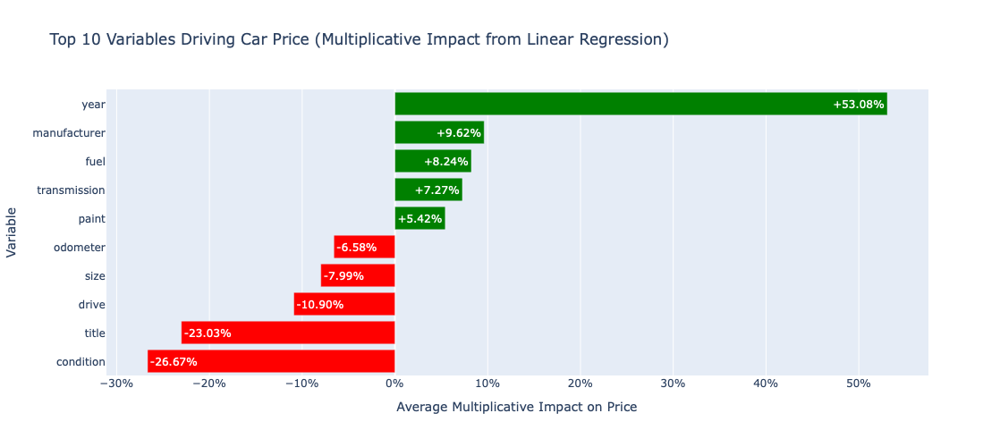

In [139]:
import pandas as pd
import numpy as np
import plotly.express as px

# Get the one-hot encoder from the pipeline
ohe = linear_pipeline.named_steps['preprocess'].named_transformers_['cat']
encoded_cat_features = ohe.get_feature_names_out(categorical_cols)
all_features = numeric_cols + list(encoded_cat_features)

# Get coefficients from Linear regression
linear_model = linear_pipeline.named_steps['model']
coefs = linear_model.coef_

coef_df = pd.DataFrame({
    "feature": all_features,
    "coefficient": coefs
})

def simplify_feature(name):
    if name in numeric_cols:
        return name
    return name.split("_")[0]

coef_df["variable"] = coef_df["feature"].apply(simplify_feature)

summary_df = (
    coef_df.groupby("variable")["coefficient"]
    .mean()  # preserve sign
    .reset_index()
    .sort_values(by="coefficient", key=abs, ascending=False)  # sort by absolute impact
)

# Keep only top 10 most impactful variables and make a copy
top_features = summary_df.head(10).copy()

top_features['coefficient_impact'] = top_features['coefficient'].apply(np.expm1)

# Add color column: positive = increase price (green), negative = decrease price (red)
top_features["color"] = top_features["coefficient"].apply(lambda x: "green" if x >= 0 else "red")

#  Plot with x-axis in percentage impact and colored bars
# Now we plot the 'coefficient_impact' column and label the axis accordingly
fig = px.bar(
    top_features,
    x="coefficient_impact",  # Use the new, more meaningful column
    y="variable",
    orientation="h",
    title="Top 10 Variables Driving Car Price (Multiplicative Impact from Linear Regression)",
    labels={"coefficient_impact": "Average Multiplicative Impact on Price", "variable": "Variable"},
    text=top_features["coefficient_impact"].apply(lambda x: f"{x:+.2%}"), # Format as percentage
    color="color",
    color_discrete_map={"green":"green","red":"red"},
    height=500
)

# Format x-axis ticks as a percentage
fig.update_layout(
    xaxis_tickformat=".0%",
    yaxis={'categoryorder':'total ascending'},
    showlegend=False
)

fig.show()

### Ridge Regression Pipeline

In [140]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_validate, KFold
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.linear_model import Ridge
import warnings
warnings.filterwarnings('ignore', category=UserWarning, module='sklearn.preprocessing._encoders')

# Separate features and target
X = filtered_vehicles.drop("price", axis=1)
y = np.log1p(filtered_vehicles['price'])  # log(1 + price)

# Train-test split
X_train_ridge, X_test_ridge, y_train_ridge, y_test_ridge = train_test_split(X, y, test_size=0.2, random_state=42)

# Identify column types
categorical_cols = X.select_dtypes(include=['object']).columns.tolist()
numeric_cols = X.select_dtypes(include=['int64','float64']).columns.tolist()

# Preprocessing: scale numeric, one-hot encode categorical
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_cols)
    ]
)

# Build Ridge Regression pipeline
ridge_pipeline = Pipeline([
    ('preprocess', preprocessor),
    ('model', Ridge(alpha=1.0))  # alpha is the regularization strength
])

# Define scorers
scoring = {
    'MSE': 'neg_mean_squared_error',
    'MAE': 'neg_mean_absolute_error',
    'R2': 'r2'
}

# Cross-validation with multiple metrics
cv_results = cross_validate(ridge_pipeline, X_train_ridge, y_train_ridge, cv=5, scoring=scoring, return_train_score=False)

# Compute RMSE from MSE
rmse_scores = np.sqrt(-cv_results['test_MSE'])

print("Cross-Validation Metrics (5 folds):")
print(f"Mean RMSE: {rmse_scores.mean():.2f} | Std RMSE: {rmse_scores.std():.2f}")
print(f"Mean MSE: {-cv_results['test_MSE'].mean():.2f} | Std MSE: {cv_results['test_MSE'].std():.2f}")
print(f"Mean MAE: {-cv_results['test_MAE'].mean():.2f} | Std MAE: {cv_results['test_MAE'].std():.2f}")
print(f"Mean R2: {cv_results['test_R2'].mean():.2f} | Std R2: {cv_results['test_R2'].std():.2f}")

Cross-Validation Metrics (5 folds):
Mean RMSE: 0.47 | Std RMSE: 0.00
Mean MSE: 0.22 | Std MSE: 0.00
Mean MAE: 0.31 | Std MAE: 0.00
Mean R2: 0.69 | Std R2: 0.00


In [141]:
# Fit on full training data
ridge_pipeline.fit(X_train_ridge, y_train_ridge)

,steps,"[('preprocess', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [142]:
# Predict on test set
y_pred_ridge = ridge_pipeline.predict(X_test_ridge)

In [143]:
# invert the log(1 + price) transform to get predictions in original price units
y_test_orig_ridge = np.expm1(y_test_ridge)   # true prices
y_pred_orig_ridge = np.expm1(y_pred_ridge)   # predicted prices (dollars)

In [144]:
# Evaluate
# metrics on original scale (dollars)
mse_orig_ridge = mean_squared_error(y_test_orig_ridge, y_pred_orig_ridge)
rmse_orig_ridge = np.sqrt(mse_orig_ridge)
mae_orig_ridge = mean_absolute_error(y_test_orig_ridge, y_pred_orig_ridge)
r2_orig_ridge = r2_score(y_test_orig_ridge, y_pred_orig_ridge)

print(f"Ridge Test RMSE (original scale): ${rmse_orig_ridge:,.2f}")
print(f"Ridge Test MSE  (original scale): ${mse_orig_ridge:,.2f}")
print(f"Ridge Test MAE  (original scale): ${mae_orig_ridge:,.2f}")
print(f"Ridge Test R2   (original scale): {r2_orig_ridge:.3f}")

Ridge Test RMSE (original scale): $7,655.44
Ridge Test MSE  (original scale): $58,605,818.82
Ridge Test MAE  (original scale): $4,672.87
Ridge Test R2   (original scale): 0.716


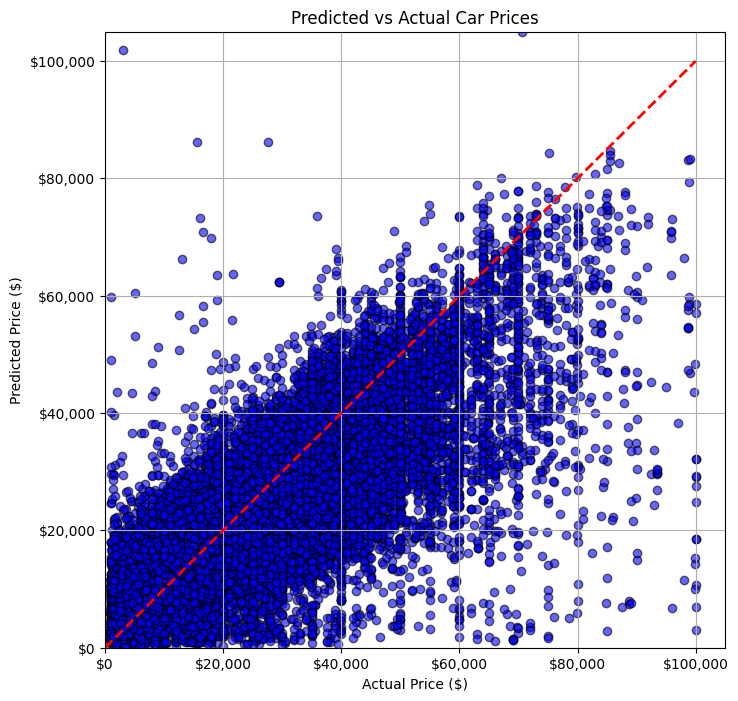

In [145]:
import matplotlib.pyplot as plt

# Predicted prices
y_pred_orig_ridge = np.expm1(ridge_pipeline.predict(X_test_ridge))  # revert log1p if using log
y_test_orig_ridge = np.expm1(y_test_ridge)  # true prices in dollars

plt.figure(figsize=(8,8))
plt.scatter(y_test_orig_ridge, y_pred_orig_ridge, alpha=0.6, color='blue', edgecolor='k')

# Plot y=x reference line (perfect predictions)
plt.plot([0, max(y_test_orig_ridge)], [0, max(y_test_orig_ridge)], color='red', linestyle='--', linewidth=2)

plt.title("Predicted vs Actual Car Prices")
plt.xlabel("Actual Price ($)")
plt.ylabel("Predicted Price ($)")
plt.xlim(0, max(y_test_orig_ridge)*1.05)
plt.ylim(0, max(y_test_orig_ridge)*1.05)
plt.grid(True)

# Optional: format x/y ticks as dollars
from matplotlib.ticker import FuncFormatter
formatter = FuncFormatter(lambda x, pos: f'${x:,.0f}')
plt.gca().xaxis.set_major_formatter(formatter)
plt.gca().yaxis.set_major_formatter(formatter)

plt.savefig("images/predicted_vs_actual_car_prices_ridge.png", dpi=300, bbox_inches="tight")

plt.show()

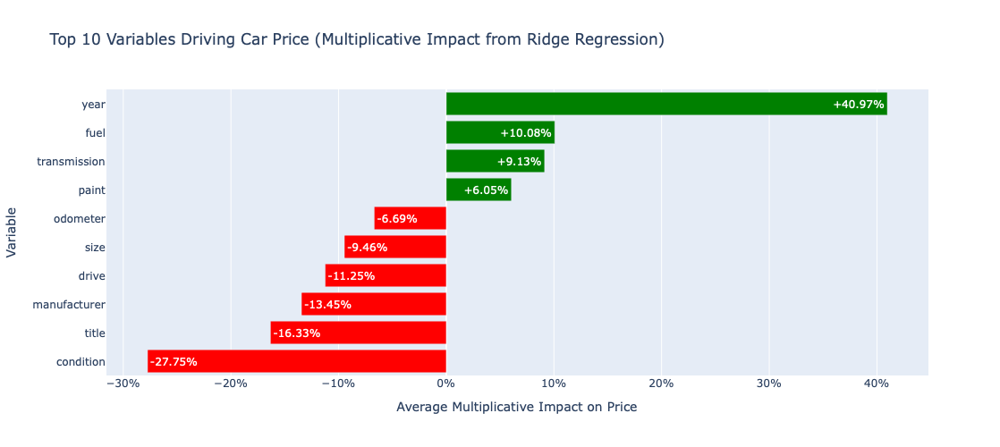

In [146]:
import pandas as pd
import numpy as np
import plotly.express as px

# Get the one-hot encoder from the Ridge pipeline
ohe = ridge_pipeline.named_steps['preprocess'].named_transformers_['cat']
encoded_cat_features = ohe.get_feature_names_out(categorical_cols)
all_features = numeric_cols + list(encoded_cat_features)

# Get coefficients from Ridge regression
ridge_model = ridge_pipeline.named_steps['model']
coefs = ridge_model.coef_

# Build DataFrame
coef_df = pd.DataFrame({
    "feature": all_features,
    "coefficient": coefs
})

# Simplify feature names back to main variable names
def simplify_feature(name):
    if name in numeric_cols:
        return name
    return name.split("_")[0]

coef_df["variable"] = coef_df["feature"].apply(simplify_feature)

# Aggregate by variable
summary_df = (
    coef_df.groupby("variable")["coefficient"]
    .mean()  # preserve sign
    .reset_index()
    .sort_values(by="coefficient", key=abs, ascending=False)  # sort by absolute impact
)

# Keep only top 10
top_features = summary_df.head(10).copy()

# Transform coefficients to multiplicative impact
top_features['coefficient_impact'] = top_features['coefficient'].apply(np.expm1)

# Add color column: positive = increase price (green), negative = decrease price (red)
top_features["color"] = top_features["coefficient"].apply(lambda x: "green" if x >= 0 else "red")

# Plot
fig = px.bar(
    top_features,
    x="coefficient_impact",
    y="variable",
    orientation="h",
    title="Top 10 Variables Driving Car Price (Multiplicative Impact from Ridge Regression)",
    labels={"coefficient_impact": "Average Multiplicative Impact on Price", "variable": "Variable"},
    text=top_features["coefficient_impact"].apply(lambda x: f"{x:+.2%}"),
    color="color",
    color_discrete_map={"green":"green","red":"red"},
    height=500
)

# Format x-axis ticks as percentages
fig.update_layout(
    xaxis_tickformat=".0%",
    yaxis={'categoryorder':'total ascending'},
    showlegend=False
)
fig.show()

### Lasso Regression Pipeline

In [147]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, cross_validate
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.linear_model import Lasso
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
import warnings

warnings.filterwarnings('ignore', category=UserWarning, module='sklearn.preprocessing._encoders')

# Separate features and target
X = filtered_vehicles.drop("price", axis=1)
y = np.log1p(filtered_vehicles['price'])  # log(1 + price)

# Train-test split
X_train_lasso, X_test_lasso, y_train_lasso, y_test_lasso = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Identify column types
categorical_cols = X.select_dtypes(include=['object']).columns.tolist()
numeric_cols = X.select_dtypes(include=['int64','float64']).columns.tolist()

# Preprocessing pipeline
preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), numeric_cols),
        ('cat', OneHotEncoder(drop='first', handle_unknown='ignore'), categorical_cols)
    ]
)

# Lasso regression pipeline
lasso_pipeline = Pipeline([
    ('preprocess', preprocessor),
    ('model', Lasso(alpha=0.0001, max_iter=10000))  # smaller alpha for better fit
])

# Cross-validation
scoring = {
    'MSE': 'neg_mean_squared_error',
    'MAE': 'neg_mean_absolute_error',
    'R2': 'r2'
}

cv_results = cross_validate(
    lasso_pipeline, 
    X_train_lasso, 
    y_train_lasso, 
    cv=5, 
    scoring=scoring, 
    return_train_score=False
)

# Compute RMSE from negative MSE
rmse_scores = np.sqrt(-cv_results['test_MSE'])

print("Lasso Regression 5-Fold Cross-Validation Metrics:")
print(f"Mean RMSE: {rmse_scores.mean():.2f} | Std RMSE: {rmse_scores.std():.2f}")
print(f"Mean MSE: {-cv_results['test_MSE'].mean():.2f} | Std MSE: {cv_results['test_MSE'].std():.2f}")
print(f"Mean MAE: {-cv_results['test_MAE'].mean():.2f} | Std MAE: {cv_results['test_MAE'].std():.2f}")
print(f"Mean R²: {cv_results['test_R2'].mean():.3f} | Std R²: {cv_results['test_R2'].std():.3f}")

Lasso Regression 5-Fold Cross-Validation Metrics:
Mean RMSE: 0.55 | Std RMSE: 0.00
Mean MSE: 0.30 | Std MSE: 0.00
Mean MAE: 0.40 | Std MAE: 0.00
Mean R²: 0.575 | Std R²: 0.003


In [149]:
# Fit the model
lasso_pipeline.fit(X_train_lasso, y_train_lasso)

,steps,"[('preprocess', ...), ('model', ...)]"
,transform_input,None
,memory,None
,verbose,False
,transformers,"[('num', ...), ('cat', ...)]"
,remainder,'drop'
,sparse_threshold,0.3
,n_jobs,None
,transformer_weights,None
,verbose,False
,verbose_feature_names_out,True


In [150]:
# Predict on test set
y_pred_lasso = lasso_pipeline.predict(X_test_lasso)

# invert the log(1 + price) transform to get predictions in original price units
y_test_orig_lasso = np.expm1(y_test_lasso)   # true prices
y_pred_orig_lasso = np.expm1(y_pred_lasso)   # predicted prices (dollars)

# Evaluate
# metrics on original scale (dollars)
mse_orig_lasso = mean_squared_error(y_test_orig_lasso, y_pred_orig_lasso)
rmse_orig_lasso = np.sqrt(mse_orig_lasso)
mae_orig_lasso = mean_absolute_error(y_test_orig_lasso, y_pred_orig_lasso)
r2_orig_lasso = r2_score(y_test_orig_lasso, y_pred_orig_lasso)

print(f"Lasso Test RMSE (original scale): ${rmse_orig_lasso:,.2f}")
print(f"Lasso Test MSE  (original scale): ${mse_orig_lasso:,.2f}")
print(f"Lasso Test MAE  (original scale): ${mae_orig_lasso:,.2f}")
print(f"Lasso Test R2   (original scale): {r2_orig_lasso:.3f}")

Lasso Test RMSE (original scale): $9,552.31
Lasso Test MSE  (original scale): $91,246,567.94
Lasso Test MAE  (original scale): $6,265.30
Lasso Test R2   (original scale): 0.558


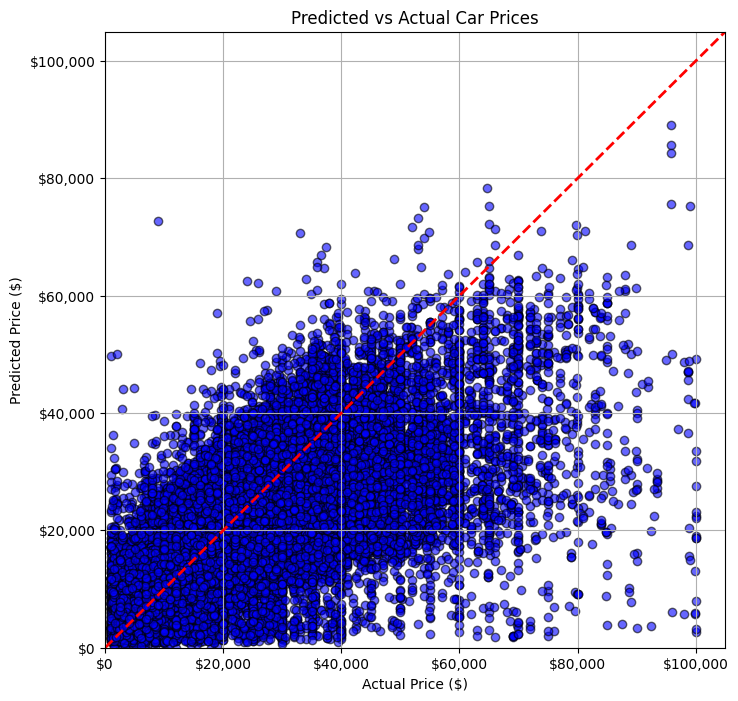

In [151]:
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter
import numpy as np

# Predicted prices
y_pred_orig_lasso = np.expm1(lasso_pipeline.predict(X_test_lasso))  # revert log1p
y_test_orig_lasso = np.expm1(y_test_lasso)  # true prices in dollars

plt.figure(figsize=(8,8))

# Scatter plot
plt.scatter(
    y_test_orig_lasso,
    y_pred_orig_lasso,
    alpha=0.6,
    color='blue',
    edgecolors='black'  # fixed warning (edgecolor instead of edgecolor='k')
)

# Plot y=x reference line (perfect predictions)
max_val = max(y_test_orig_lasso.max(), y_pred_orig_lasso.max()) * 1.05
plt.plot([0, max_val], [0, max_val], color='red', linestyle='--', linewidth=2)

plt.title("Predicted vs Actual Car Prices")
plt.xlabel("Actual Price ($)")
plt.ylabel("Predicted Price ($)")
plt.xlim(0, max_val)
plt.ylim(0, max_val)
plt.grid(True)

# Format x/y ticks as dollars
formatter = FuncFormatter(lambda x, pos: f'${x:,.0f}')
plt.gca().xaxis.set_major_formatter(formatter)
plt.gca().yaxis.set_major_formatter(formatter)

plt.savefig("images/predicted_vs_actual_car_prices_lasso.png", dpi=300, bbox_inches="tight")

plt.show()

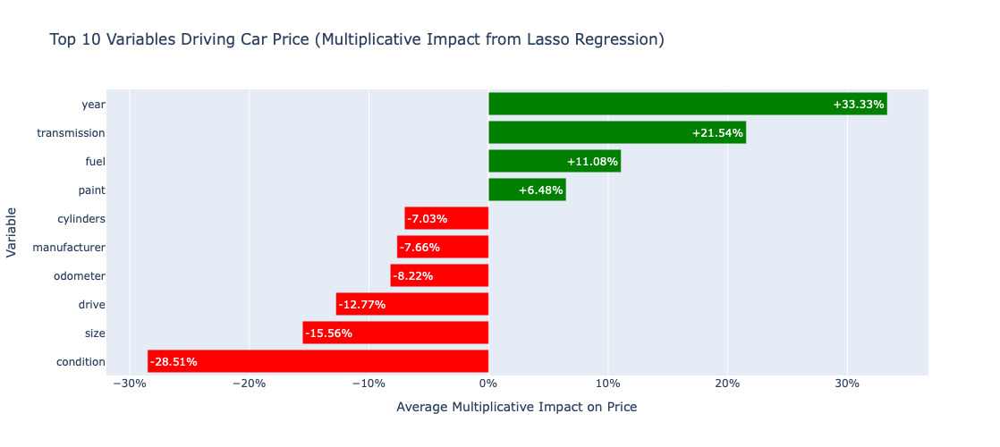

In [152]:
import pandas as pd
import numpy as np
import plotly.express as px

# Get the one-hot encoder from the Ridge pipeline
ohe = lasso_pipeline.named_steps['preprocess'].named_transformers_['cat']
encoded_cat_features = ohe.get_feature_names_out(categorical_cols)
all_features = numeric_cols + list(encoded_cat_features)

# Get coefficients from Ridge regression
lasso_model = lasso_pipeline.named_steps['model']
coefs = lasso_model.coef_

# Build DataFrame
coef_df = pd.DataFrame({
    "feature": all_features,
    "coefficient": coefs
})

# Simplify feature names back to main variable names
def simplify_feature(name):
    if name in numeric_cols:
        return name
    return name.split("_")[0]

coef_df["variable"] = coef_df["feature"].apply(simplify_feature)

# Aggregate by variable
summary_df = (
    coef_df.groupby("variable")["coefficient"]
    .mean()  # preserve sign
    .reset_index()
    .sort_values(by="coefficient", key=abs, ascending=False)  # sort by absolute impact
)

# Keep only top 10
top_features = summary_df.head(10).copy()

# Transform coefficients to multiplicative impact
top_features['coefficient_impact'] = top_features['coefficient'].apply(np.expm1)

# Add color column: positive = increase price (green), negative = decrease price (red)
top_features["color"] = top_features["coefficient"].apply(lambda x: "green" if x >= 0 else "red")

# Plot
fig = px.bar(
    top_features,
    x="coefficient_impact",
    y="variable",
    orientation="h",
    title="Top 10 Variables Driving Car Price (Multiplicative Impact from Lasso Regression)",
    labels={"coefficient_impact": "Average Multiplicative Impact on Price", "variable": "Variable"},
    text=top_features["coefficient_impact"].apply(lambda x: f"{x:+.2%}"),
    color="color",
    color_discrete_map={"green":"green","red":"red"},
    height=500
)

# Format x-axis ticks as percentages
fig.update_layout(
    xaxis_tickformat=".0%",
    yaxis={'categoryorder':'total ascending'},
    showlegend=False
)

fig.show()

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high-quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight into drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

=== Regression Model Metrics in $ ===
    Model             MSE       RMSE        MAE        R2
0  Linear  $60,746,647.53  $7,794.01  $4,446.29  0.705660
1   Ridge  $58,605,818.82  $7,655.44  $4,672.87  0.716033
2   Lasso  $91,246,567.94  $9,552.31  $6,265.30  0.557877


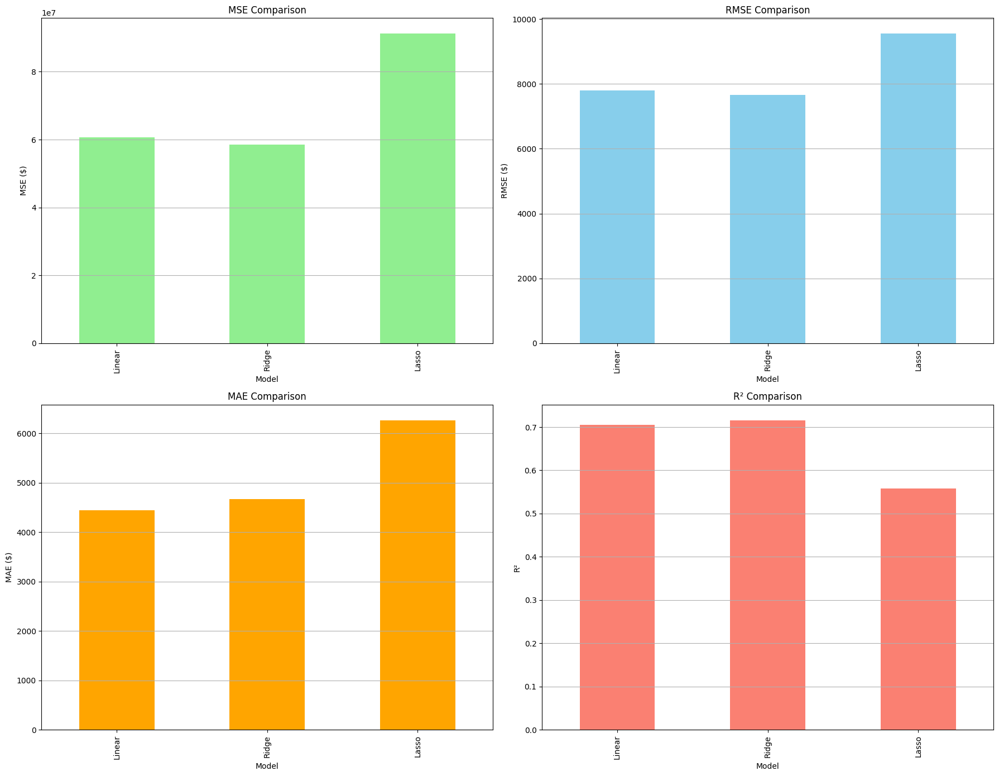

In [153]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

# Target was log-transformed, revert it to dollars
y_true_linear_dollars = np.expm1(y_test_linear)
y_true_ridge_dollars  = np.expm1(y_test_ridge)
y_true_lasso_dollars  = np.expm1(y_test_lasso)

y_pred_linear_dollars = np.expm1(linear_pipeline.predict(X_test_linear))
y_pred_ridge_dollars  = np.expm1(ridge_pipeline.predict(X_test_ridge))
y_pred_lasso_dollars  = np.expm1(lasso_pipeline.predict(X_test_lasso))


# Metrics calculation function
def get_metrics(y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    return mse, rmse, mae, r2

# Calculate metrics for each model
metrics_linear = get_metrics(y_true_linear_dollars, y_pred_linear_dollars)
metrics_ridge  = get_metrics(y_true_ridge_dollars, y_pred_ridge_dollars)
metrics_lasso  = get_metrics(y_true_lasso_dollars, y_pred_lasso_dollars)

# Create summary DataFrame
metrics_df = pd.DataFrame({
    'Model': ['Linear', 'Ridge', 'Lasso'],
    'MSE': [metrics_linear[0], metrics_ridge[0], metrics_lasso[0]],
    'RMSE': [metrics_linear[1], metrics_ridge[1], metrics_lasso[1]],
    'MAE': [metrics_linear[2], metrics_ridge[2], metrics_lasso[2]],
    'R2': [metrics_linear[3], metrics_ridge[3], metrics_lasso[3]]
})

# Format MSE, RMSE, MAE as dollars for display
metrics_df_display = metrics_df.copy()
metrics_df_display[['MSE','RMSE','MAE']] = metrics_df_display[['MSE','RMSE','MAE']].map(lambda x: f"${x:,.2f}")

print("=== Regression Model Metrics in $ ===")
print(metrics_df_display)


# Visual Comparison (numeric values)
fig, axes = plt.subplots(2, 2, figsize=(18,14))

# MSE Comparison
metrics_df.set_index('Model')['MSE'].plot(kind='bar', ax=axes[0,0], color='lightgreen')
axes[0,0].set_title('MSE Comparison')
axes[0,0].set_ylabel('MSE ($)')
axes[0,0].grid(axis='y')

# RMSE Comparison
metrics_df.set_index('Model')['RMSE'].plot(kind='bar', ax=axes[0,1], color='skyblue')
axes[0,1].set_title('RMSE Comparison')
axes[0,1].set_ylabel('RMSE ($)')
axes[0,1].grid(axis='y')

# MAE Comparison
metrics_df.set_index('Model')['MAE'].plot(kind='bar', ax=axes[1,0], color='orange')
axes[1,0].set_title('MAE Comparison')
axes[1,0].set_ylabel('MAE ($)')
axes[1,0].grid(axis='y')

# R2 Comparison
metrics_df.set_index('Model')['R2'].plot(kind='bar', ax=axes[1,1], color='salmon')
axes[1,1].set_title('R² Comparison')
axes[1,1].set_ylabel('R²')
axes[1,1].grid(axis='y')

plt.savefig("images/regression_model_metrics_comparison.png", dpi=500, bbox_inches="tight")  # Save first

plt.tight_layout()
plt.show()

**Interpretation of Regression Model Metrics** <br> 
Mean Squared Error (MSE), Root Mean Squared Error (RMSE), Mean Absolute Error (MAE), and R-squared (R^2).
 * **Mean Squared Error (MSE) and Root Mean Squared Error (RMSE):** These metrics measure the average squared difference and the square root of the average squared difference between the predicted and actual values. Lower values indicate better performance.
   * Observation: The MSE and RMSE plots both show that the Ridge model has the lowest values, followed closely by the Linear model. The Lasso model has a significantly higher MSE and RMSE. This suggests that both the Linear and Ridge models have better predictive accuracy and smaller overall errors compared to the Lasso model.
 * **Mean Absolute Error (MAE):** This metric measures the average absolute difference between the predicted and actual values. Like MSE and RMSE, a lower value indicates a better-performing model.
   * Observation: The MAE plot shows that the Linear model has the lowest MAE, followed by the Ridge model. The Lasso model has the highest MAE, indicating that its predictions, on average, are farther from the actual values than those of the other two models.
 * **R-squared (R^2)**: This metric represents the proportion of the variance in the dependent variable that is predictable from the independent variable(s). It ranges from 0 to 1, with a value closer to 1 indicating a better fit.
   * Observation: The R^2 plot shows that the Ridge model has the highest R^2 value (approximately 0.7168), followed very closely by the Linear model (approximately 0.7056). The Lasso model has a noticeably lower R^2 value (approximately 0.5578). This indicates that the Ridge and Linear models explain a greater proportion of the variance in the data than the Lasso model.

**Conclusion: Best Model to Use** <br>
Based on the comprehensive comparison of the metrics, the Ridge model is the best model to use.
 * It has the lowest RMSE and MSE, indicating it has the best predictive accuracy with the smallest overall error.
 * It has the highest R^2 value, meaning it explains the largest proportion of the variance in the target variable.
 * While the Linear model has a slightly lower MAE, the superior performance of the Ridge model across the other three metrics (lowest MSE/RMSE, highest R^2) makes it the more robust and reliable choice.
   
In summary, the Ridge model provides the best balance of predictive accuracy and explanatory power, making it the top choice among the three models tested.


### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine-tuning their inventory.

**CRISP-DM Deployment Report: Fine-Tuning Your Used Car Inventory** <br>
Date: 09-18-2025<br>
To: Used Car Dealership Management <br>
Subject: Recommendations for Optimizing Used Car Inventory Pricing

1. Executive Summary
 * The Challenge: You asked us to help you improve pricing strategies for your used car inventory. The goal was to better understand market value and set competitive prices that maximize profit and turn over.
 * Our Solution: We developed and tested several machine learning models to predict the market price of a used car based on its key features.
 * Primary Finding: Our analysis indicates that the Ridge Regression model is the most effective tool for this purpose. It consistently provided the most accurate price predictions and explained the highest percentage of market value fluctuations.
 * Recommendation: We recommend that you use the insights from this model to inform your pricing decisions for new inventory acquisitions and existing stock. This will allow you to price vehicles more strategically, improving profitability and sales velocity.
2. Our Approach & Model Selection <br>
We tested three different regression models to find the best fit for predicting used car prices. The chart below compares their performance across key metrics.
(Reference the "Regression Model Metrics" chart.)
<center>
    <img src = images/regression_model_metrics_comparison.png width = 100%/>
</center>
 * Model Performance: The Ridge model (as shown by its green bars in the MSE/RMSE charts and the highest red bar in the R² chart) consistently performed best. It had the lowest error rates and was able to explain the most variance in car prices.
 * Why Not the Others? The Linear model performed well but was slightly less accurate than Ridge. The Lasso model performed significantly worse, meaning its predictions were less reliable. This is why we've chosen the Ridge model as the foundation for our recommendations.
3. Key Findings: What Drives the Price of a Car? <br>
Our analysis not only provides you with the best predictive model but also reveals the most important factors that influence a used car's price. The following chart shows the top 10 variables with the most significant impact on a car's value, sorted by their average effect.<br>
(Reference the "Top 10 Variables Driving Car Price (Multiplicative Impact)" chart.)
<center>
    <img src = images/top_ten_features_driving_car_price_ridge_regression.png width = 100%/>
</center>
 * Positive Price Drivers (Green Bars):
   * Year (+40.97%): This is by far the biggest positive driver. A car that is one year newer is, on average, worth nearly 41% more. This highlights the immense value of acquiring newer models.
   * Fuel (+10.08%), Transmission (+9.13%), and Paint (+6.05%): These variables show that certain features and market preferences can significantly increase a car's price. For example, a car with a desirable fuel type (e.g., hybrid), a certain transmission (e.g., automatic), or a preferred color can command a premium.
 * Negative Price Drivers (Red Bars):
   * Condition (-27.75%): This is the single largest negative factor. A car with a poor condition (e.g., major mechanical issues, damage) will lose over 27% of its value, on average. This is your number one risk to look out for.
   * Title (-16.33%): A car with a non-clean title (e.g., salvage, rebuilt) will lose over 16% of its value.
   * Manufacturer (-13.45%), Drive (-11.25%), and Size (-9.46%): These show that brand, drivetrain, and vehicle size are also important factors that can negatively impact a car's price if they are less desirable to the market.
   * Odometer (-6.69%): High mileage is a clear detractor, reducing a car's value by an average of nearly 7% for every additional increment (based on the model's unit).
4. How to Use This Information <br>
This data is your playbook for success. We have delivered the final model to your team. Here is how you can begin to use it:
 * Inventory Acquisition: Use the model as a guide to assess new vehicles. Prioritize cars with desirable features (newer year, popular fuel/transmission types) and a clean condition and title. Avoid vehicles with major negative impacts, as they will be difficult to sell at a profitable price.
 * Strategic Pricing: For your current inventory, use the model's recommendations as a starting point for setting competitive list prices. The model can provide a data-driven price point that accounts for all the key variables.
 * Training & Support: We are available to train your sales and management teams on how to interpret and use the model's outputs effectively.
5. Next Steps
 * Pilot Program: We suggest implementing this tool on a small portion of your inventory for a 30-day pilot to see the benefits firsthand.
 * Feedback Loop: Provide us with feedback on the model's performance in real-world scenarios. We will use this information to refine the model further.
